**<center><h1>Edge Detection Techniques with OpenCV</h1></center>**

## **Step 1. Import Libraries**

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

## **Step 2. Edge Detection**

In [2]:
def image_edge_detection(image_path):  
    # image preprocessing
    original_img = cv2.imread(image_path, cv2.IMREAD_COLOR)
    gray = cv2.cvtColor(original_img, cv2.COLOR_BGR2GRAY) # convert image to grayscale becasue edge detection works with grayscale images 
    blur_img = cv2.GaussianBlur(gray,(3,3),0) # use gaussianblur to reduce image noise
    
    #Roberts Cross edge detector
    # Apply Roberts Cross kernels
    kernel_x = np.array([[1, 0],
                         [0, -1]])
    kernel_y = np.array([[0, 1],
                         [-1, 0]])                         
    # Convolve the image with the kernels
    horizontal_edges = cv2.filter2D(gray, -1, kernel_x)
    vertical_edges = cv2.filter2D(gray, -1, kernel_y)
    # Ensure both arrays have the same data type
    horizontal_edges = np.float32(horizontal_edges)
    vertical_edges = np.float32(vertical_edges)
    # Compute gradient magnitude
    gradient_magnitude = cv2.magnitude(horizontal_edges, vertical_edges)
    # Apply thresholding to highlight edges
    threshold = 50
    _, edges_robert_cross = cv2.threshold(gradient_magnitude, threshold, 255, cv2.THRESH_BINARY)
    
    #Sobel edge detector
    sobelx = cv2.Sobel(src=blur_img, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=5) 
    filtered_image_x = cv2.convertScaleAbs(sobelx)
    sobely = cv2.Sobel(src=blur_img, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=5)
    filtered_image_y = cv2.convertScaleAbs(sobely)
    sobelxy = cv2.Sobel(src=blur_img, ddepth=cv2.CV_64F, dx=1, dy=1, ksize=5)
    filtered_image_xy = cv2.convertScaleAbs(sobelxy)
    
    # Canny edge detector
    edges = cv2.Canny(image=blur_img, threshold1=50, threshold2=100)
    
    # Laplacian edge detector
    laplacian = cv2.Laplacian(blur_img,5,cv2.CV_64F)
    filtered_image_laplacian = cv2.convertScaleAbs(laplacian)
    
    #display obtained images
    plt.figure(figsize=(24,12)) 
    plt.subplot(241)
    plt.imshow(original_img)
    plt.title("Original image")
    plt.axis("off")
    
    plt.subplot(242)
    plt.imshow(blur_img)
    plt.title("Converted to Grayscale")
    plt.axis("off")
    
    plt.subplot(243)
    plt.imshow(edges_robert_cross, cmap='gray')
    plt.title('Robert Cross') 
    plt.axis("off")

    plt.subplot(244)
    plt.imshow(filtered_image_x, cmap='gray')
    plt.title('Sobel X') 
    plt.axis("off")

    plt.subplot(245)
    plt.imshow(filtered_image_y, cmap='gray')
    plt.title('Sobel Y') 
    plt.axis("off")

    plt.subplot(246)
    plt.imshow(filtered_image_xy, cmap='gray')
    plt.title('Sobel X Y')
    plt.axis("off")
    
    plt.subplot(247)
    plt.imshow(edges, cmap='gray')
    plt.title('Canny')
    plt.axis("off")

    plt.subplot(248)
    plt.imshow(filtered_image_laplacian, cmap='gray')
    plt.title('Laplacian')
    plt.axis("off")

    plt.show()

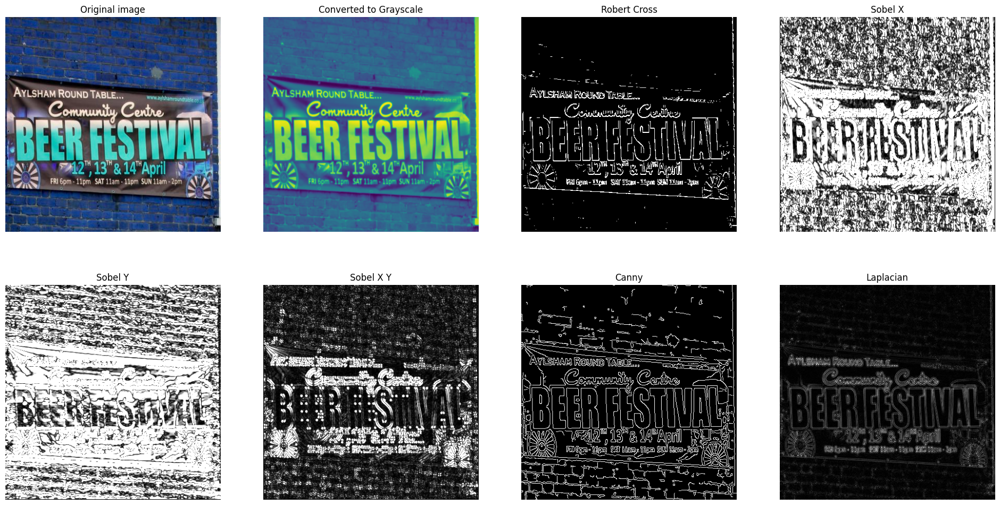

In [3]:
image_edge_detection("/kaggle/input/images-different-conditions-for-ocr/normal images/a70208a69db49a2d_jpg.rf.d071190b9bc86b44137fd4efb8461a03.jpg")

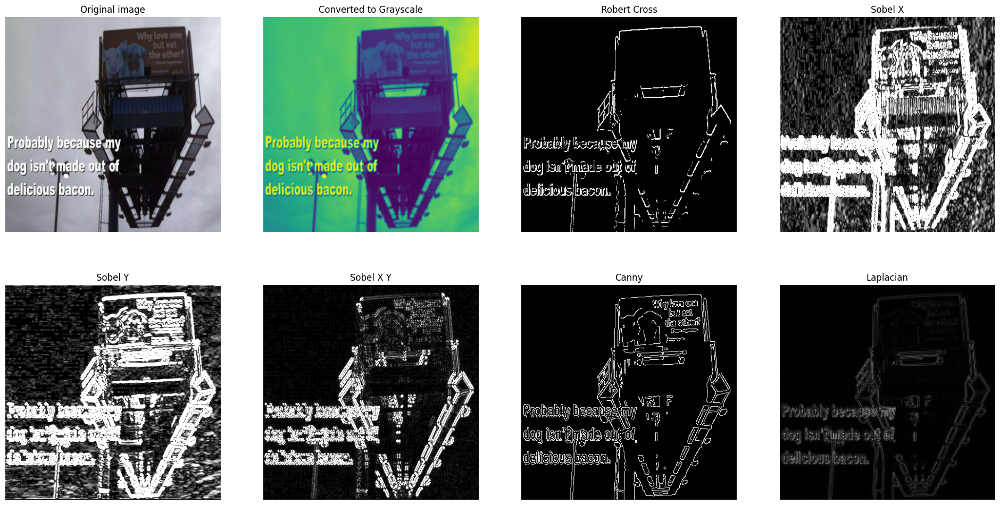

In [4]:
image_edge_detection("/kaggle/input/images-different-conditions-for-ocr/dark images/341c93c6824fed2e_jpg.rf.f0b16ef9bda4661625ff0dfb7a43c836.jpg")

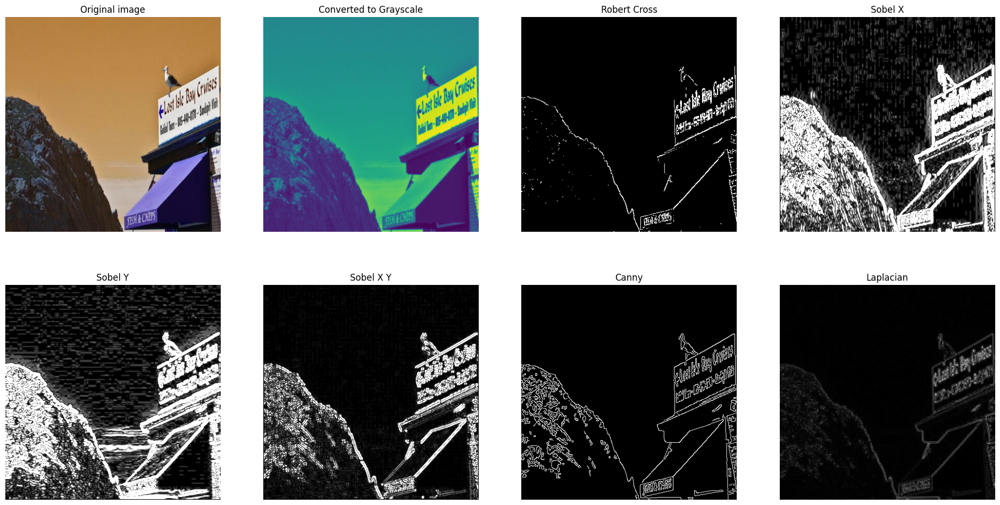

In [5]:
image_edge_detection("/kaggle/input/images-different-conditions-for-ocr/different angles/9382cfa97e1581e0_jpg.rf.a159a06f6d8da3f57a3948006447b0c0.jpg")

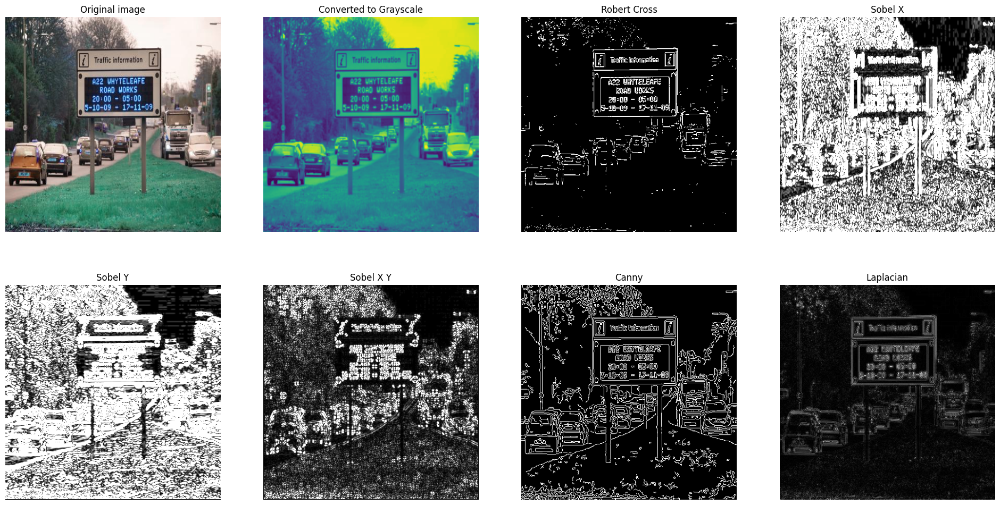

In [6]:
image_edge_detection("/kaggle/input/images-different-conditions-for-ocr/normal images/4540076b317e318c_jpg.rf.ed7b88e410f61dbb2dcd8bd08a8b4972.jpg")

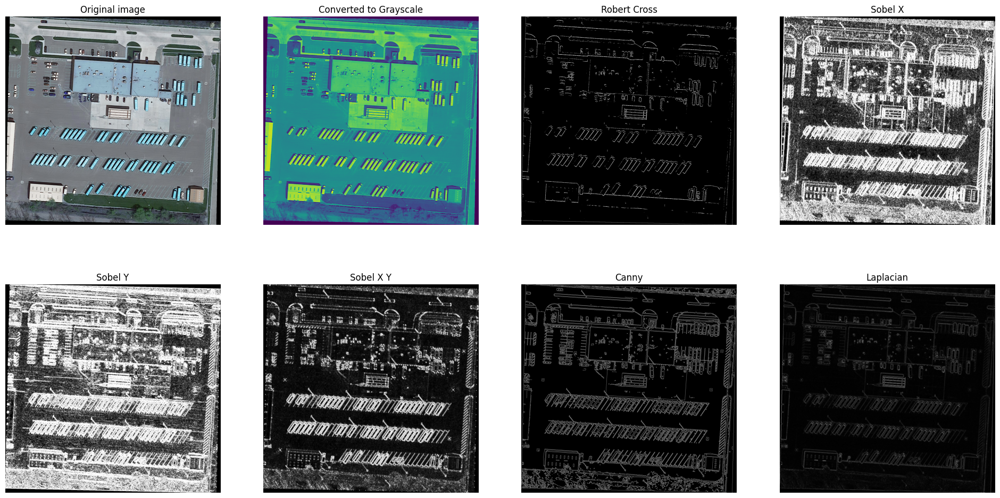

In [7]:
image_edge_detection("/kaggle/input/dota-data/DOTA/test/images/P0015.png")

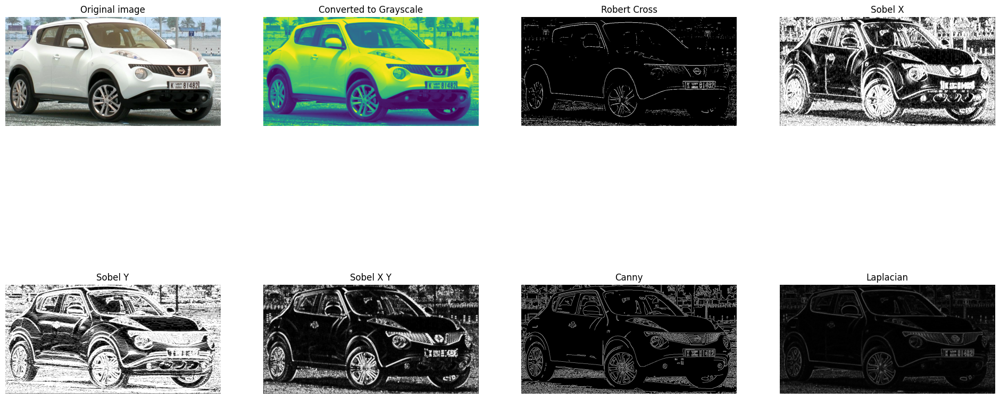

In [8]:
image_edge_detection("/kaggle/input/cars-body-type-cropped/Cars_Body_Type/train/Hatchback/00024_Nissan-Juke-Hatchback-2012_jpg.rf.816718c0e801494e7f56e26defa544a6.jpg")

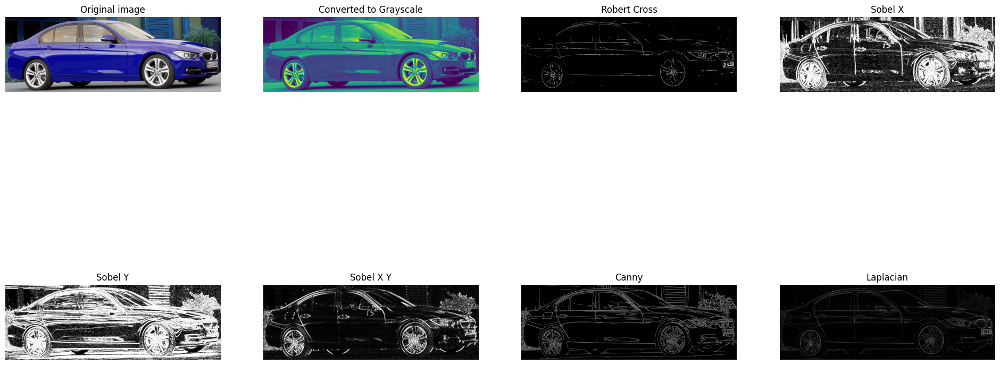

In [9]:
image_edge_detection("/kaggle/input/cars-body-type-cropped/Cars_Body_Type/train/Sedan/00125_BMW-3-Series-Sedan-2012_jpg.rf.d2612b3388929a1518c5f4671a64ab2a.jpg")

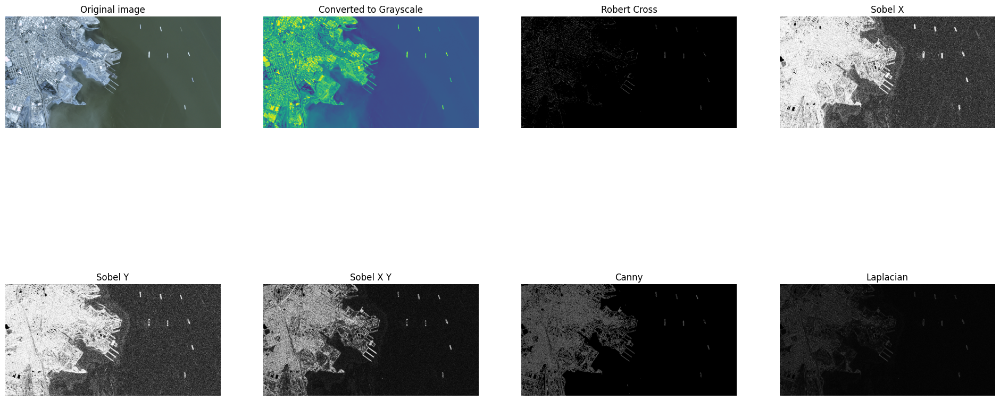

In [10]:
image_edge_detection("/kaggle/input/ships-in-satellite-imagery/scenes/scenes/sfbay_2.png")

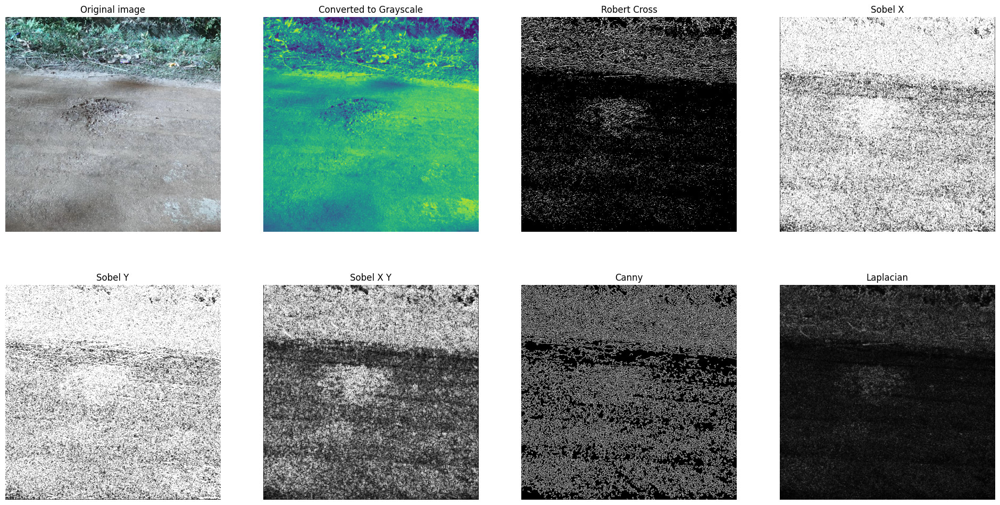

In [11]:
image_edge_detection("/kaggle/input/annotated-potholes-dataset/annotated-images/img-100.jpg")

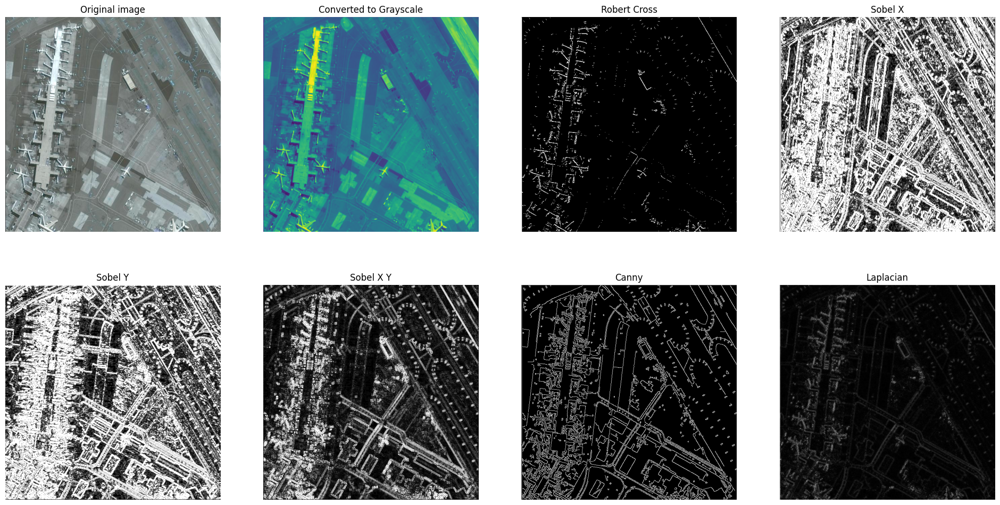

In [12]:
image_edge_detection("/kaggle/input/tiny-object-detection/SkyFusion/train/014de911-7810-4f7d-8967-3e5402209f4a_1060_1060_jpg.rf.1cd6d6165c0cbe0662444868a97943c0.jpg")

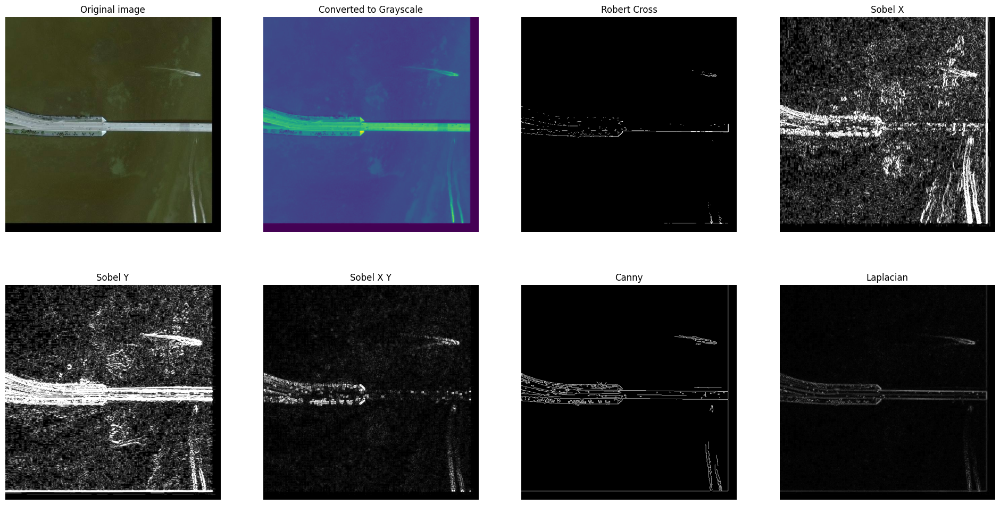

In [13]:
image_edge_detection("/kaggle/input/tiny-object-detection/SkyFusion/valid/07a03de23_png_jpg.rf.0c3838e58260eaecc0be7581acc12074.jpg")